<a href="https://colab.research.google.com/github/AliKemalIstanbullu/P1---Fire-Detection-and-Localization-Using-Surveillance-Camera/blob/main/fireDetection_rev28October2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Şişe algılayıcı Yolov5**

# **Kurulum**

In [1]:
#clone YOLOv5 and
!git clone https://github.com/ultralytics/yolov5  # repostory'i klonluyoruz
%cd yolov5
%pip install -qr requirements.txt # gerekli kütüphaneleri install ediyoruz
%pip install -q roboflow #roboflow u install ediyoruz

import torch
import os
from IPython.display import Image, clear_output  # resimleri görüntülemek için

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})") #hangi ekran kartını kullandığımızı yazdırıyoruz

Cloning into 'yolov5'...
remote: Enumerating objects: 16026, done.
remote: Counting objects: 100% (59/59), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 16026 (delta 33), reused 41 (delta 25), pack-reused 15967
Receiving objects: 100% (16026/16026), 14.67 MiB | 18.30 MiB/s, done.
Resolving deltas: 100% (10995/10995), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.8/644.8 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 21.6 MB/

# **Roboflowu aktif ediyoruz ve roboflowdaki verisetimizi indiriyoruz**

In [2]:
from roboflow import Roboflow
rf = Roboflow(api_key="JEWphJwqR34McoBEUne9", model_format="yolov5", notebook="ultralytics")

# !pip install roboflow

# from roboflow import Roboflow
# rf = Roboflow(api_key="JEWphJwqR34McoBEUne9")
# project = rf.workspace("durhamcollege").project("yangin-tanima")
# dataset = project.version(1).download("yolov5")

In [ ]:
# environment'ı kuruyoruz
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [3]:
#roboflowdan aldığımız api kodlarını kopyalıyoruz çalıştırınca indirecek
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="JEWphJwqR34McoBEUne9")
project = rf.workspace("durhamcollege").project("firededection")
dataset = project.version(1).download("yolov5")



# rf = Roboflow(api_key="JEWphJwqR34McoBEUne9")
# project = rf.workspace("durhamcollege").project("yangin-tanima")
# dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to fireDedection-1 in yolov5pytorch:: 100%|██████████| 367/367 [00:00<00:00, 7394.70it/s]


# **Modelin eğitimine başlıyoruz**

In [4]:
# 640 resmi 16 lık batchler halinde 100 epochda eğitecek saatler sürebilir lütfen sabırlı olun ve aralıklarla ekranın kapanmaması için ekrana basınız.
!python train.py --img 640 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

2023-10-28 19:32:36.391506: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-10-28 19:32:36.391570: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-10-28 19:32:36.391615: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/fireDedection-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync

# **Modelin başarı oranını grafikler halinde ekrana bastırıyoruz**

In [5]:
# tensorboard'ı başlatıyoruz

#"runs" isimli dosyanın içine kaydediyoruz
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

# **Test verilerimizi deniyoruz**

In [9]:
#test resimlerimizi modele sokuyoruz ve sonuçlar en sonda belirtilen dosya konumuna kaydediliyor
#her farklı resim veya video eklediğinizde en sondaki exp1 exp2 diye artar. runs/detect/exp
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640 --conf 0.2 --source {dataset.location}/valid/test_images

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/yolov5/fireDedection-1/valid/test_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-230-g53efd07 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/15 /content/yolov5/fireDedection-1/valid/test_images/Untitled00.jpg: 480x640 4 fires, 44.8ms
image 2/15 /content/yolov5/fireDedection-1/valid/test_images/Untitled01.jpg: 448x640 1 fire, 50.2ms
image 3/15 /content/yolov5/fireDedection-1/valid/test_images/Untitled02.jpg: 416x640

# **Test verilerinin son halini ekrana bastırıyoruz**

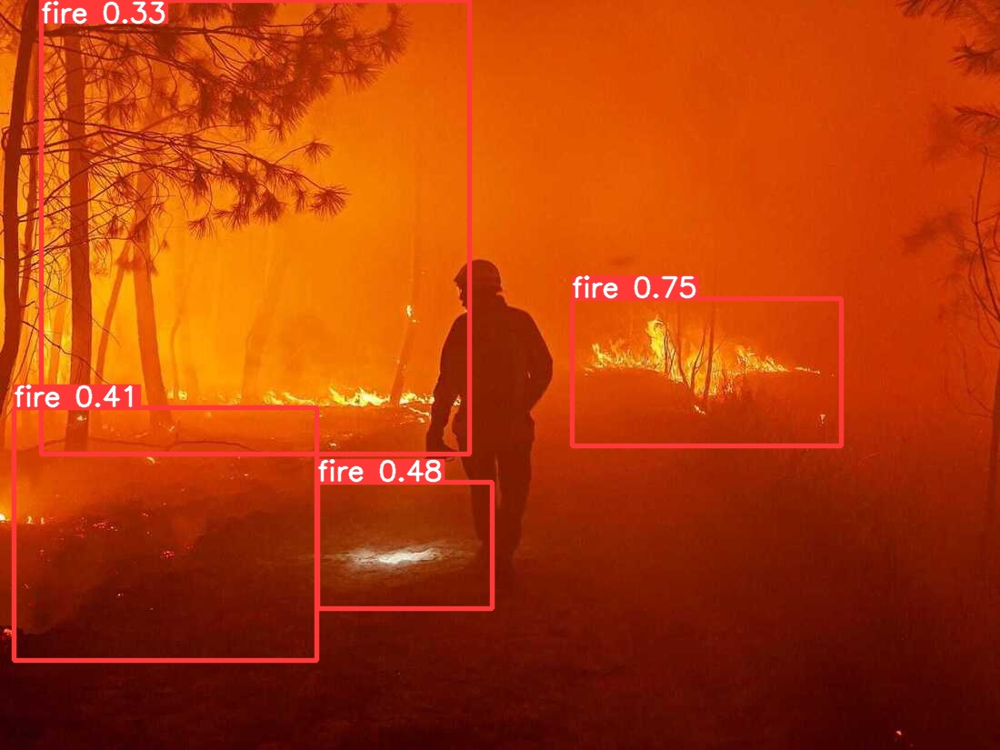

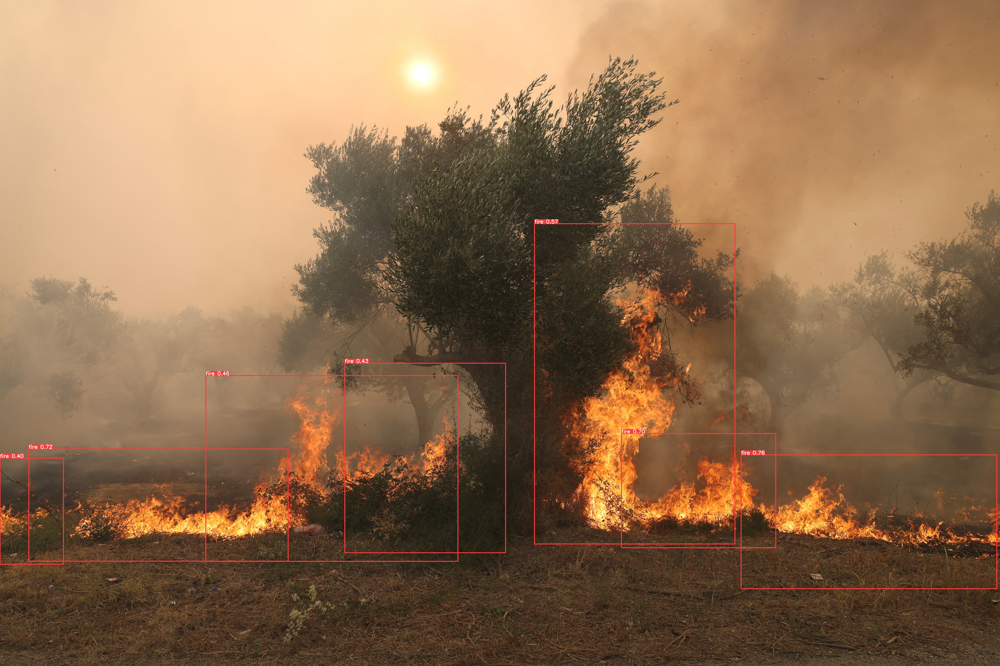

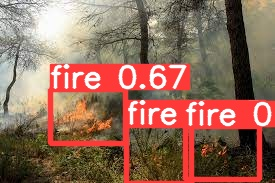

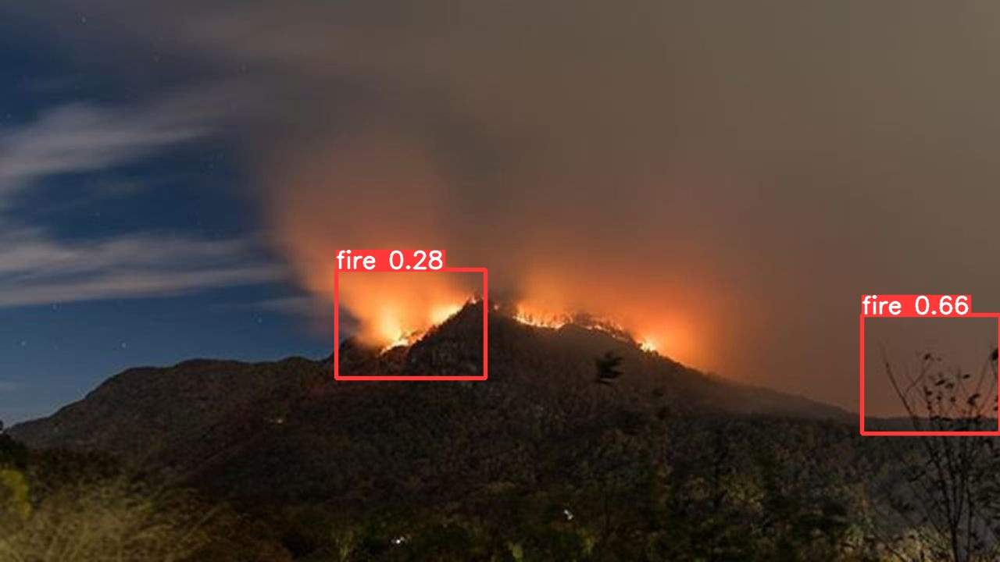

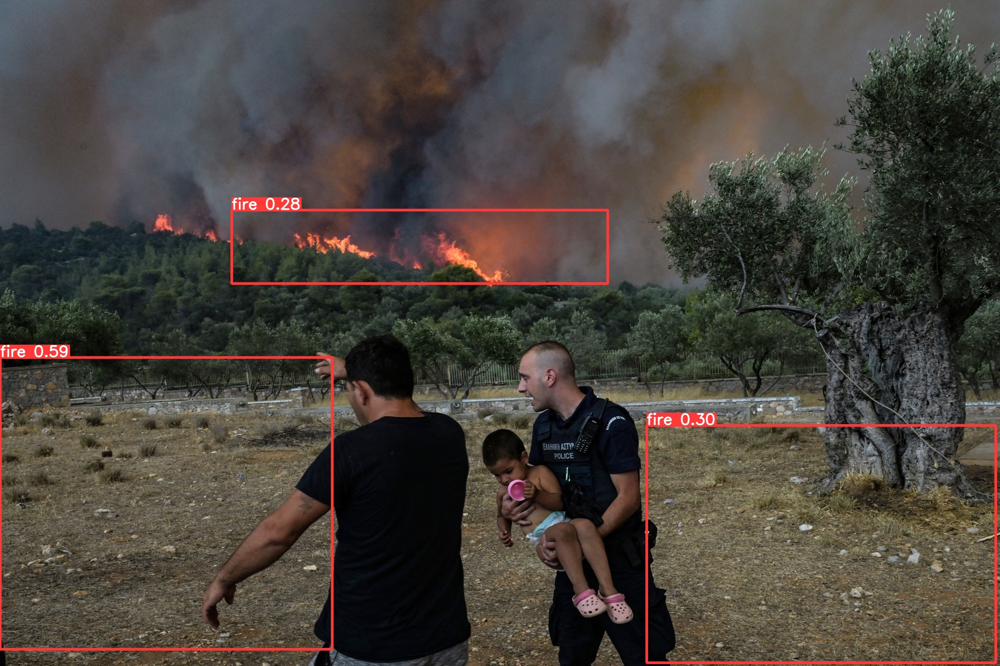

...

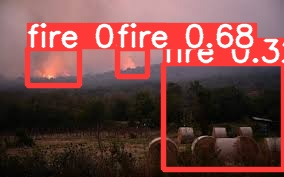

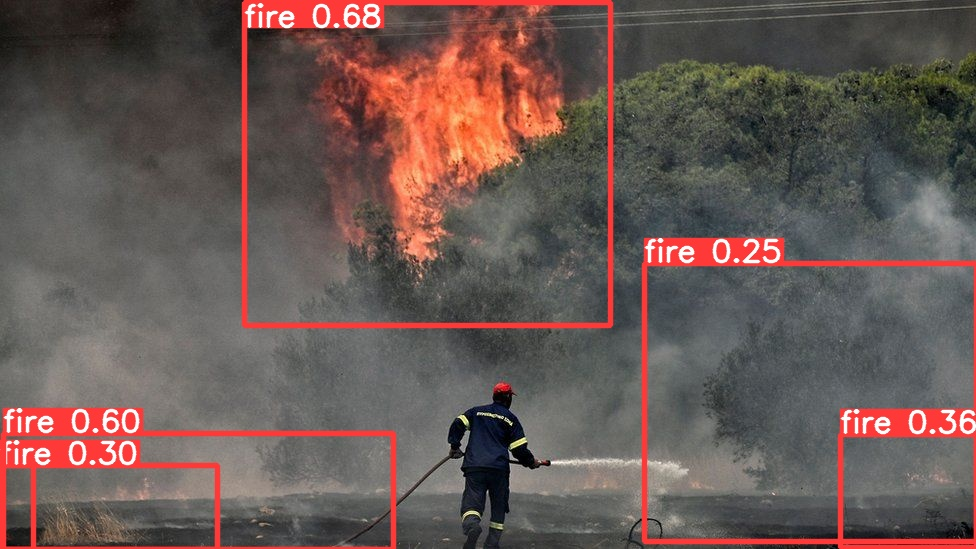

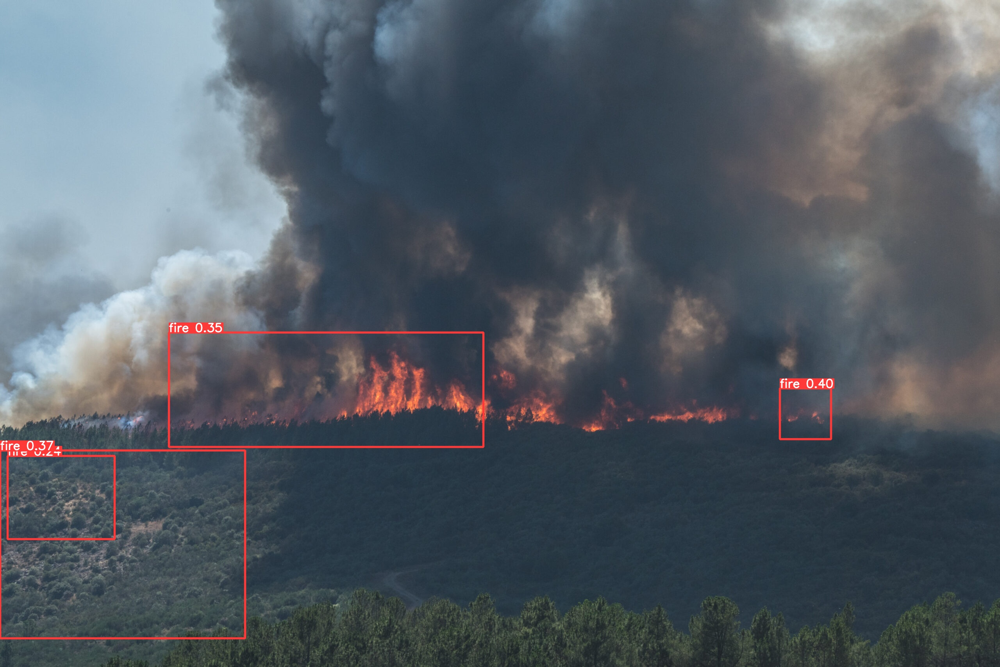

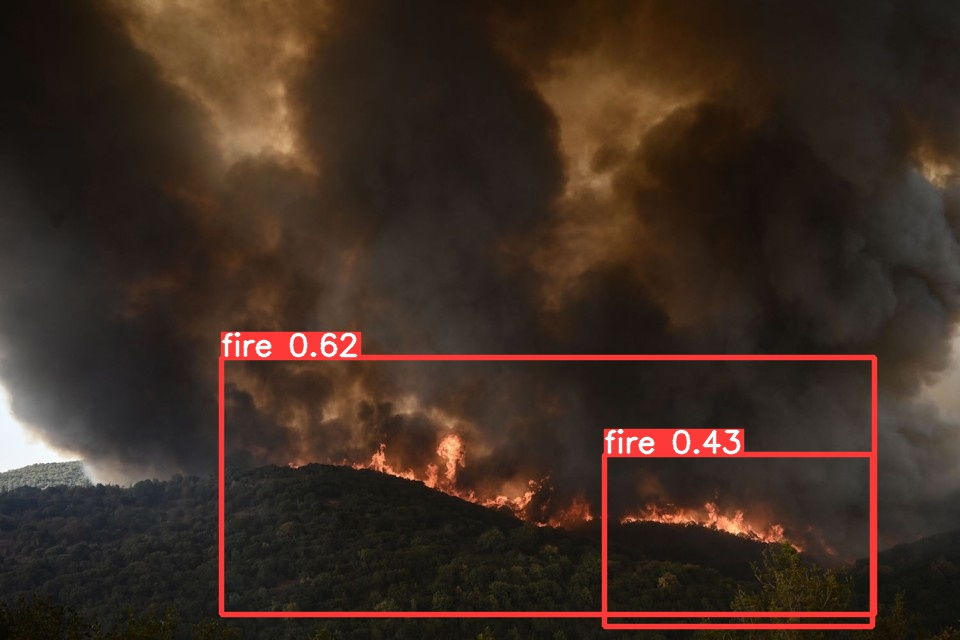

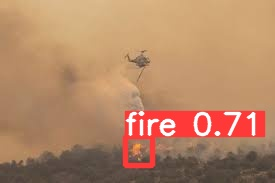

In [10]:

#modelden çıkmış olan tüm test verilerini ekrana bastırarak sonuçları inceliyoruz.

import glob
from IPython.display import Image, display

i = 0
# lütfen glob.glob un içine doğru dosya konumunu yazınız üst satırda en altta yazan results saved to runs/detects/exp1 veya runs/detects/exp2 veya runs/detects/exp3
for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #dosya uzantısını resimlerinizin formatına göre değiştirin jpg olmak zorunda değil.
    i += 1

    if i < 15:
      display(Image(filename=imageName))
      print("\n")

# **Modeli kaydediyoruz**

In [11]:
#Modelin ağırlıklarını daha sonra kullanmak için bilgisayarımıza kaydediyoruz
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')